# Latest Mark 7

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from copy import deepcopy
import shapely.geometry as shapgeo

## Read, Plot Funct

In [2]:
def read_files(ddir):
    images = dict()
    ACCEPTED_FORMAT = ['jpg', 'png']
    for d in sorted(os.listdir(ddir)):
        if d.split('.')[1].lower() in ACCEPTED_FORMAT:
            fname = d.split('.')[0]
            print(f'reading {os.path.join(ddir, d)}...')
            images[fname] = cv2.imread(os.path.join(ddir, d))
            images[fname] = cv2.cvtColor(images[fname], cv2.COLOR_BGR2RGB)
    return images

def display_all(imgs, subs=(10,10), fgsz=(15,18), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def display_all_with(imgs, cc, subs=(10,10), fgsz=(15,18), use_gray=True):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k][:,:,cc], cmap='gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def save_plots(imgs, suptitle, savedir, subs=(10,10), fgsz=(15,18), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
    fig.suptitle(suptitle)
    fig.savefig(savedir)
    print(f'Figure is successfully saved at {savedir}')

def adjust_gamma(image, gamma=1.0):
    table = np.array([((i / 255.0) ** gamma) * 255
      for i in np.arange(0, 256)]).astype("uint8")

    return cv2.LUT(image, table)

In [3]:
POSITIVE = r'/home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive'
NEGATIVE = r'/home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative'
IDEAL = r'/home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/r3_N-13-L_left_half.png'

In [4]:
neg = read_files(NEGATIVE)
ideal = cv2.imread(IDEAL)
ideal = cv2.cvtColor(ideal, cv2.COLOR_BGR2RGB)

reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/001.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/008.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/009.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/010.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/011.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/012.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/015.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/017.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/018.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/021.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/022.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/023.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/024.jpg...
reading /hom

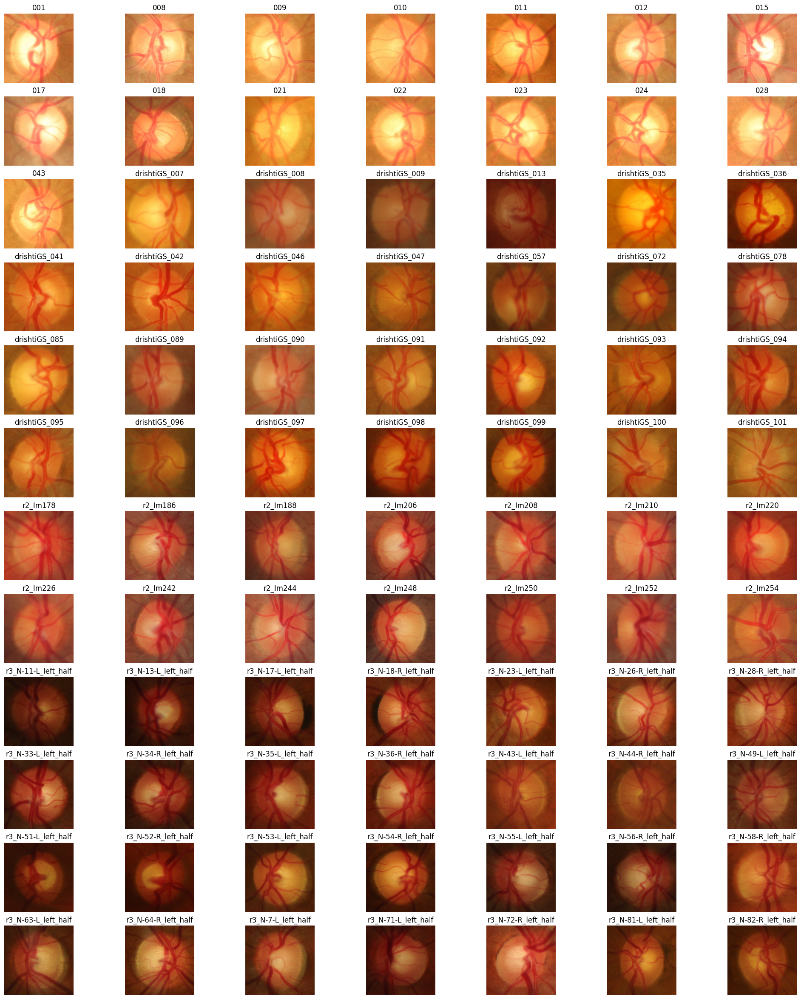

In [5]:
display_all(neg, (12,7), (25,30))

## Histogram Matching

In [6]:
from skimage.exposure import match_histograms

In [7]:
neg_matched = {}
for n in neg:
    neg_matched[n] = match_histograms(neg[n], ideal, multichannel=True)

/tmp/ipykernel_88409/2846311092.py:3: FutureWarning: `multichannel` is a deprecated argument name for `match_histograms`. It will be removed in version 1.0. Please use `channel_axis` instead.
  neg_matched[n] = match_histograms(neg[n], ideal, multichannel=True)


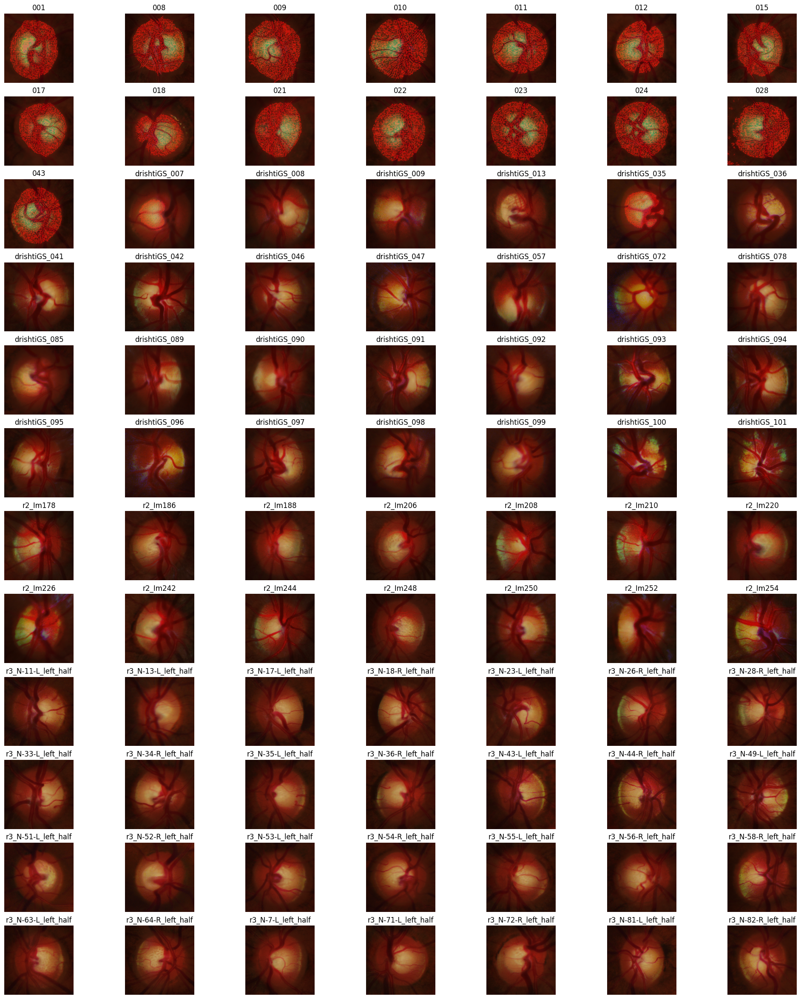

In [13]:
display_all(neg_matched, (12,7), (25,30))

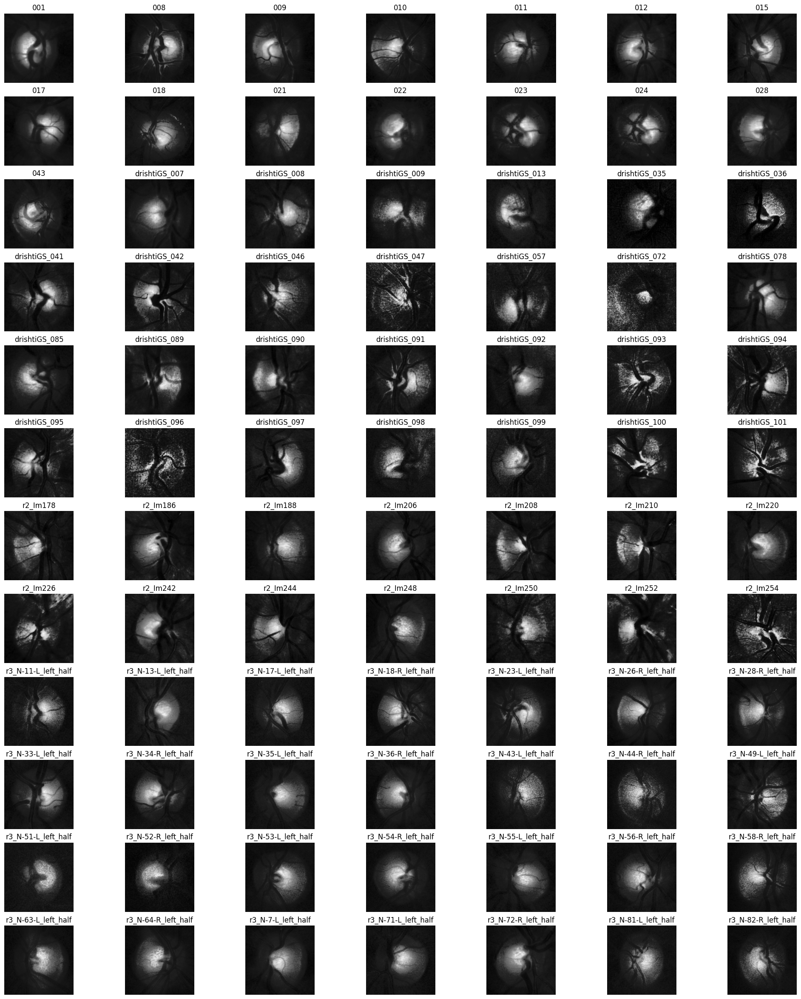

In [14]:
display_all_with(neg_matched, 2, (12,7), (25,30), True)

## Draw Funct

In [67]:
def draw_oc_line(imgs, roi_line, color):
    drawn_oc = {}
    
    for img in imgs:
        drawn_oc[img] = cv2.circle(imgs[img],roi_line[img][0],roi_line[img][1],color, 3)
    return drawn_oc

## Optic Cup Segmentation

In [133]:
def get_circle(contours):
    conts = np.array([contour.shape[0] for contour in contours])
    cont_idx = np.argmax(conts)
    (x,y), radius = cv2.minEnclosingCircle(contours[cont_idx])
    return (x,y), radius

def select_boundaries(bnrs):
    cont, hcy = cv2.findContours(bnrs, 
                                     cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = get_circle(cont)
    center = (int(x),int(y))
    radius = int(radius)
    return (center, radius)

def get_cup(imgs):
    print('mencari cup!')
    oc_lines = {}
    ocs = {}
    p = {}
    # dilation_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7))
    # erosion_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7))   
    for img in imgs:
        blue = imgs[img][:,:,1]
        gmc = adjust_gamma(blue, 1) # was 3
        blur = cv2.medianBlur(gmc, 13)
        ret, th = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        dilated = cv2.morphologyEx(th, cv2.MORPH_OPEN, kernel=np.ones((13,13), np.uint8))
        # erosion = cv2.erode(th, kernel=np.ones((3,3), np.uint8))
        # dilated = cv2.dilate(erosion, kernel=np.ones((7,7), np.uint8))
        center_rad = select_boundaries(dilated)
        oc_lines[img] = center_rad
        canvas = np.zeros_like(th, dtype='uint8')
        ocs[img] = cv2.circle(canvas, center_rad[0], center_rad[1], (255, 255, 255), -1)
    
    # display_all(p, (12,7), (25,30), True)
    print('done!')
    return oc_lines, ocs

In [134]:
oc_line, all_oc = get_cup(neg_matched)

mencari cup!
done!


In [135]:
ncopy = deepcopy(neg)

In [136]:
d_oc = draw_oc_line(ncopy, oc_line, (0, 0, 255))

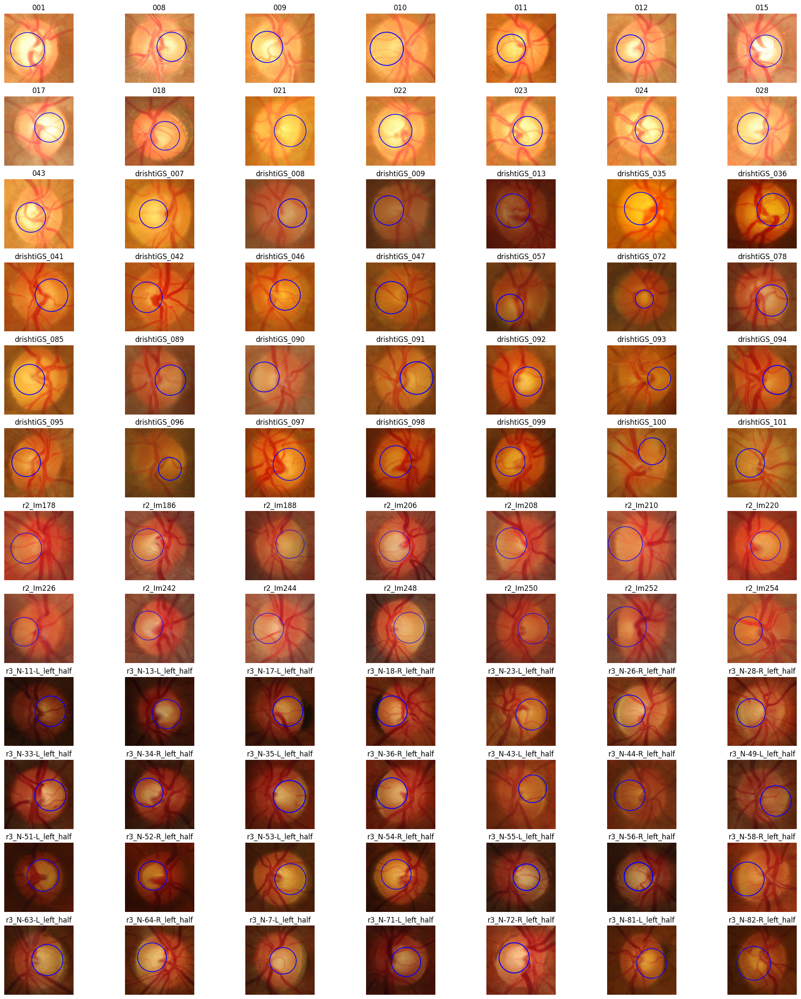

In [137]:
display_all(d_oc, (12,7), (25,30))

# Positive

In [138]:
pos = read_files(POSITIVE)

reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/036.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/069.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/158.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/159.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/160.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/228.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/229.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/245.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/247.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/273.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/277.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/289.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/293.jpg...
reading /hom

In [139]:
pos_matched = {}
for p in pos:
    pos_matched[p] = match_histograms(pos[p], ideal, multichannel=True)

/tmp/ipykernel_88409/3255611397.py:3: FutureWarning: `multichannel` is a deprecated argument name for `match_histograms`. It will be removed in version 1.0. Please use `channel_axis` instead.
  pos_matched[p] = match_histograms(pos[p], ideal, multichannel=True)


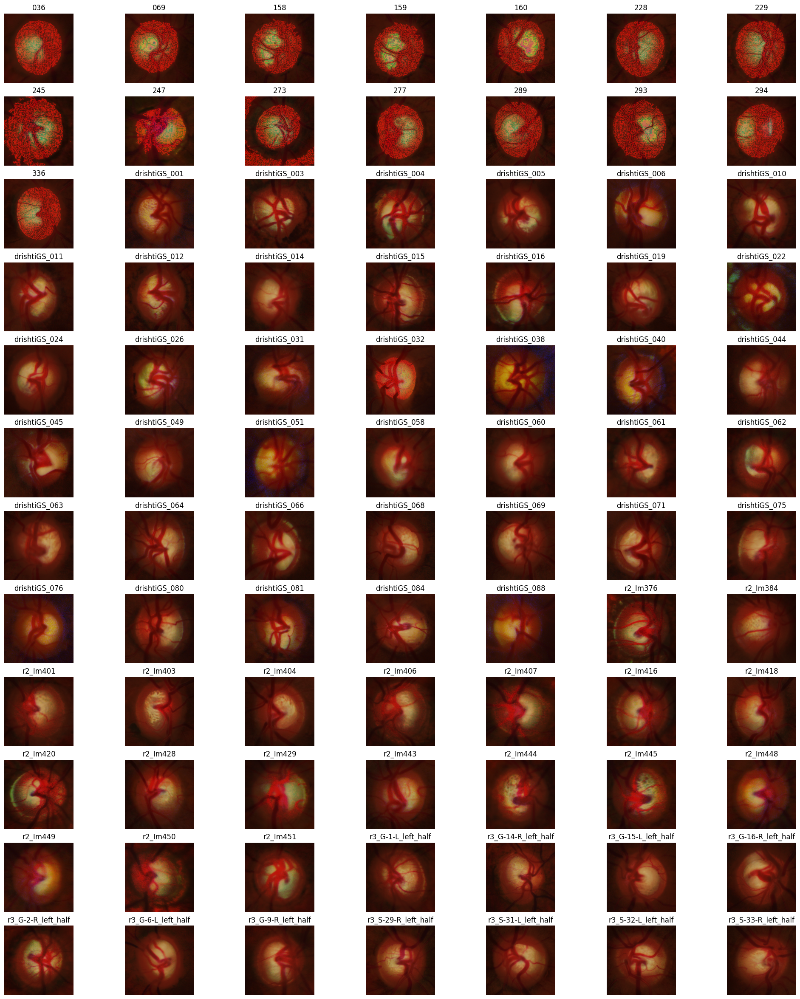

In [140]:
display_all(pos_matched, (12,7), (25,30))

In [141]:
poc = deepcopy(pos)

In [142]:
oc_line, all_oc = get_cup(pos_matched)

mencari cup!
done!


In [143]:
d_oc_pos = draw_oc_line(poc, oc_line, (0, 0, 255))

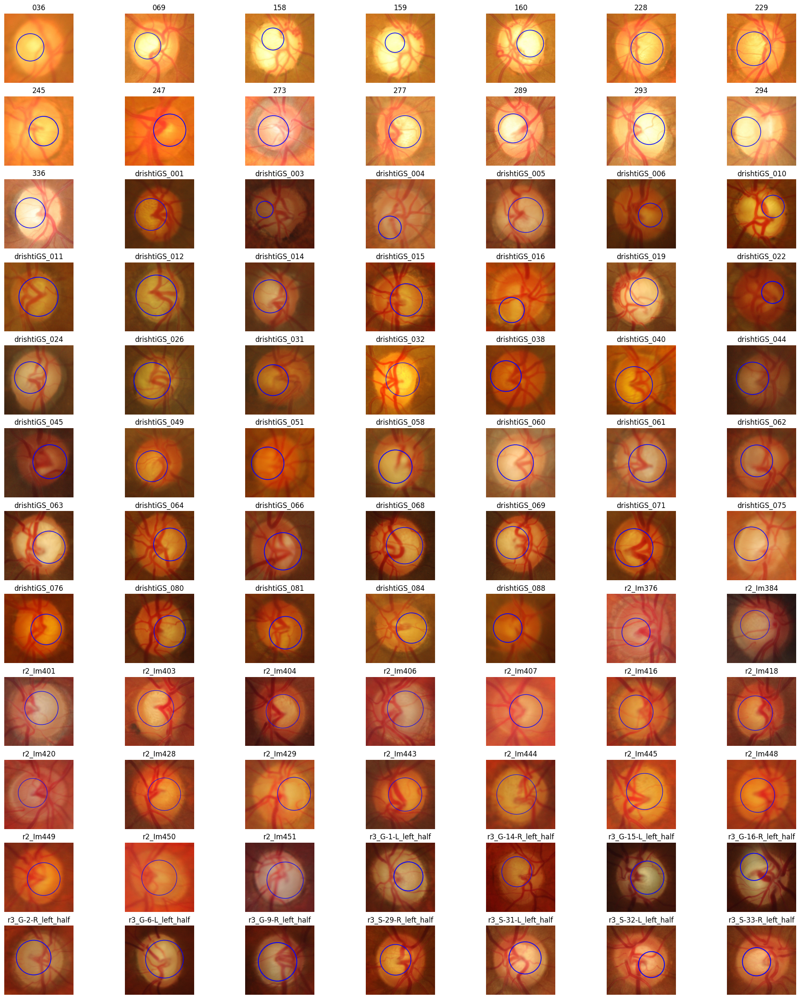

In [144]:
display_all(d_oc_pos, (12,7), (25,30), True)